In [1]:
# resnet
# PATH = "epoch=19-step=31380.ckpt"
# OVERRIDES = []

# vgg
PATH = "epoch=0-step=1569.ckpt"
OVERRIDES = ["module=vgg"]

N_IMAGES = 100

In [2]:
import os

os.chdir('..')

In [3]:
import hydra
import numpy as np
from itertools import islice
import torch
from PIL import Image, ImageDraw, ImageFont
from torchvision.transforms.functional import to_pil_image
import ipyplot


BATCH_SIZE = 1

with hydra.initialize(version_base=None, config_path="../conf"):
    config = hydra.compose(config_name="main", overrides=OVERRIDES)
    config.datamodule.batch_size = BATCH_SIZE

    data_module = hydra.utils.instantiate(config.datamodule)
    dl = data_module.val_dataloader()

    model = hydra.utils.instantiate(config.module.model)

model.load_state_dict({k[4:]: v for k, v in torch.load(PATH, map_location=torch.device("cpu"))["state_dict"].items() if k[:4] == "net."})
model.eval()

/home/ppawlik-asus/xai_crp_lrp/venv_xai/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/ppawlik-asus/xai_crp_lrp/venv_xai/lib/python3.10/site-packages/torchvision/models/_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(
/home/ppawlik-asus/xai_crp_lrp/venv_xai/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [4]:

images = []
labels = []
y_hats = []

n_imgs = [0, 0]

FNT = ImageFont.truetype("Pillow/Tests/fonts/FreeMono.ttf", 17)

for img, c in dl:
    if n_imgs[int(c.item())] == N_IMAGES:
        continue
    n_imgs[int(c.item())] += 1

    y_hat = torch.nn.Softmax(-1)(model(img))[0, 1].item()
    img = to_pil_image(img[0])
    ImageDraw.Draw(img).text((0, 0), f"y={y_hat}", (0, 0, 0), FNT)
    images.append(img)
    labels.append(c.item())
    y_hats.append(y_hat)

s = sorted(list(zip(images, labels, y_hats)), key=lambda x: x[2])
images, labels, y_hats = zip(*s)

/home/ppawlik-asus/xai_crp_lrp/venv_xai/lib/python3.10/site-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



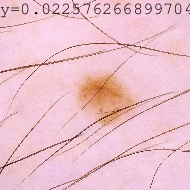
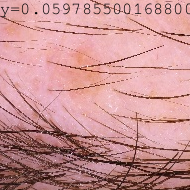
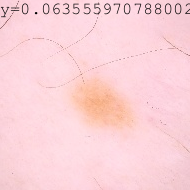
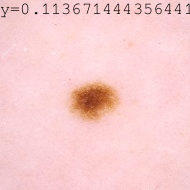
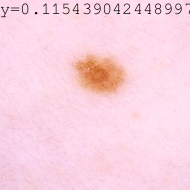
...
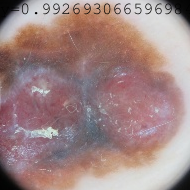
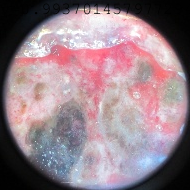
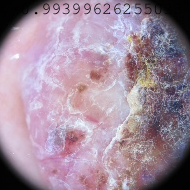
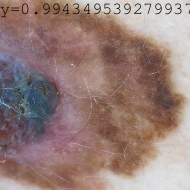
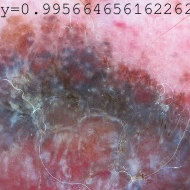

In [5]:
ipyplot.plot_class_tabs(images, labels, max_imgs_per_tab=N_IMAGES)